##### Copyright 2018 The TensorFlow Hub Authors.

Licensed under the Apache License, Version 2.0 (the "License");

In [1]:
# Copyright 2018 The TensorFlow Hub Authors. All Rights Reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# ==============================================================================

# Object detection

<table align="left"><td>
  <a target="_blank"  href="https://colab.research.google.com/github/tensorflow/hub/blob/master/examples/colab/object_detection.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab
  </a>
</td><td>
  <a target="_blank"  href="https://github.com/tensorflow/hub/blob/master/examples/colab/object_detection.ipynb">
    <img width=32px src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
</td></table>


This Colab demonstrates use of a TF-Hub module trained to perform object detection.

## Imports and function definitions


In [1]:
#@title Imports and function definitions

# Currently %tensorflow_version 2.x installs beta1, which doesn't work here.
# %tensorflow_version can likely be used after 2.0rc0  
!pip install tf-nightly-gpu-2.0-preview

# For running inference on the TF-Hub module.
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

The following GPU devices are available: 


## Example use

### Helper functions for downloading images and for visualization.

Visualization code adapted from [TF object detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/utils/visualization_utils.py) for the simplest required functionality.

In [2]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=6,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = bottom + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

def draw_boxes(image, boxes, class_names, scores, max_boxes=25, min_score=0.1): #MAX # OF BOXES IS CHANGED HERE
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("arial.ttf",
                              28) # FONT SIZE AND FONT IS CHANGED HERE
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

## Apply module

Load a public image from Open Images v4, save locally, and display.

Image downloaded to C:\Users\cchin\AppData\Local\Temp\tmpcrsozl3z.jpg.


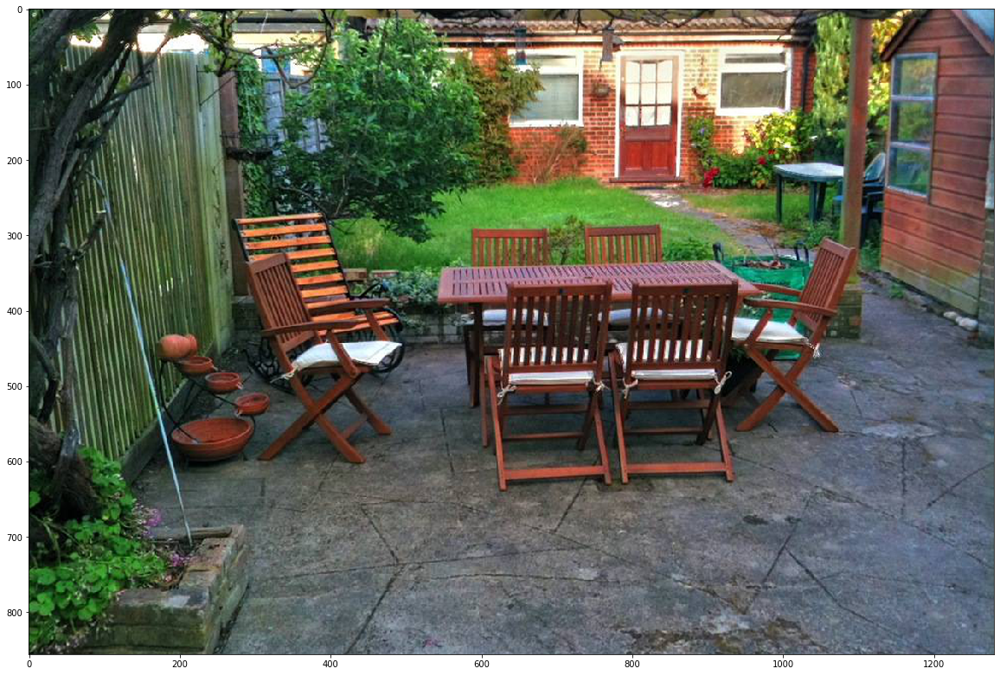

In [3]:
image_url = "https://farm1.staticflickr.com/4032/4653948754_c0d768086b_o.jpg"  #@param
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

Pick an object detection module and apply on the downloaded image. Modules:
* **FasterRCNN+InceptionResNet V2**: high accuracy,
* **ssd+mobilenet V2**: small and fast.

In [4]:
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]

detector = hub.load(module_handle).signatures['default']

OSError: SavedModel file does not exist at: C:\Users\cchin\AppData\Local\Temp\tfhub_modules\6e850c920451d5243d1fb87a3242c087535b9183/{saved_model.pbtxt|saved_model.pb}

In [8]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [9]:
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

Found 100 objects.
Inference time:  203.35540413856506
Font not found, using default font.


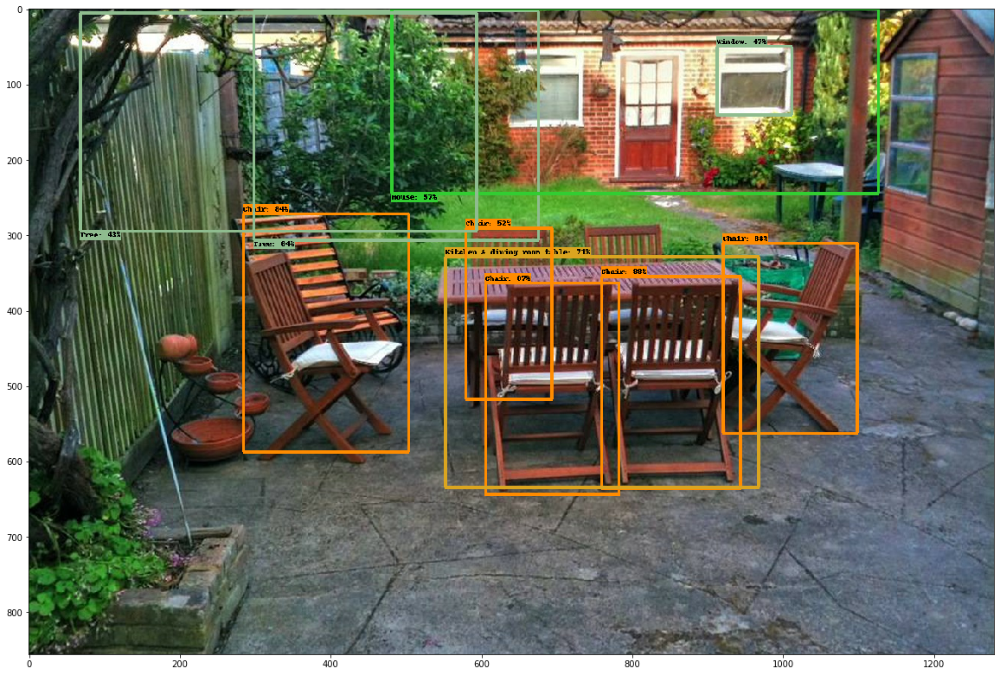

In [7]:
 #run_detector(detector, downloaded_image_path) 

### More images
Perform inference on some additional images with time tracking.


Image downloaded to C:\Users\cchin\AppData\Local\Temp\tmpnfpo_2za.jpg.
Found 100 objects.
Inference time:  109.15336608886719
Font not found, using default font.
Inference time:
Image downloaded to C:\Users\cchin\AppData\Local\Temp\tmpu8vqfo8h.jpg.
Found 100 objects.
Inference time:  109.35497689247131
Font not found, using default font.
Inference time:
Image downloaded to C:\Users\cchin\AppData\Local\Temp\tmpagud3fga.jpg.
Found 100 objects.
Inference time:  108.5496768951416
Font not found, using default font.
Inference time:


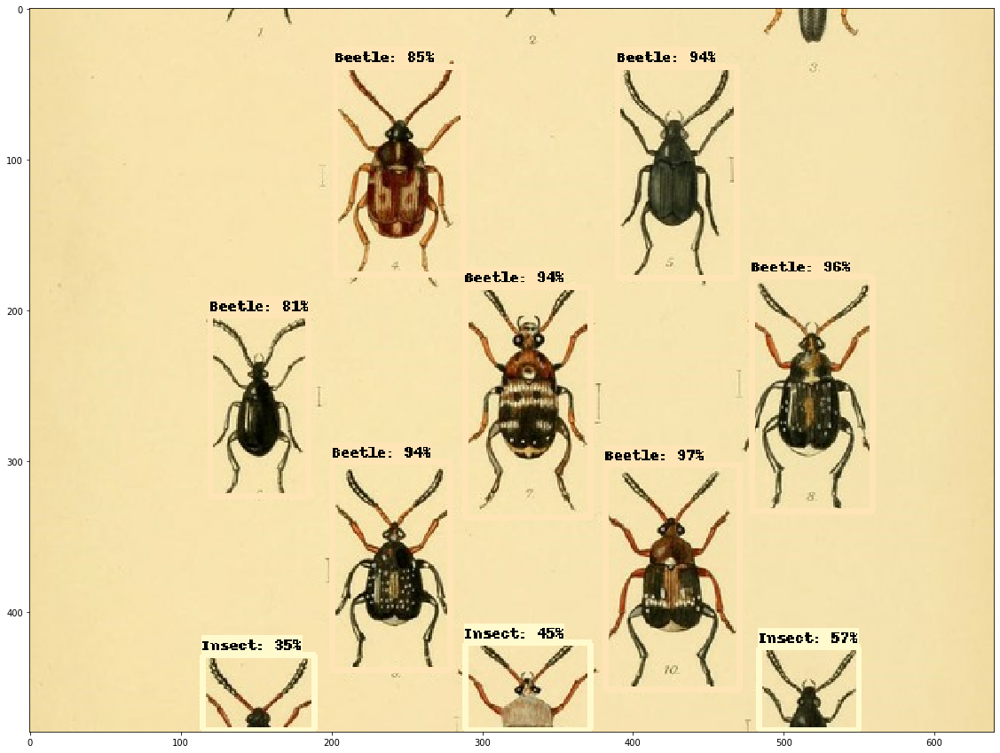

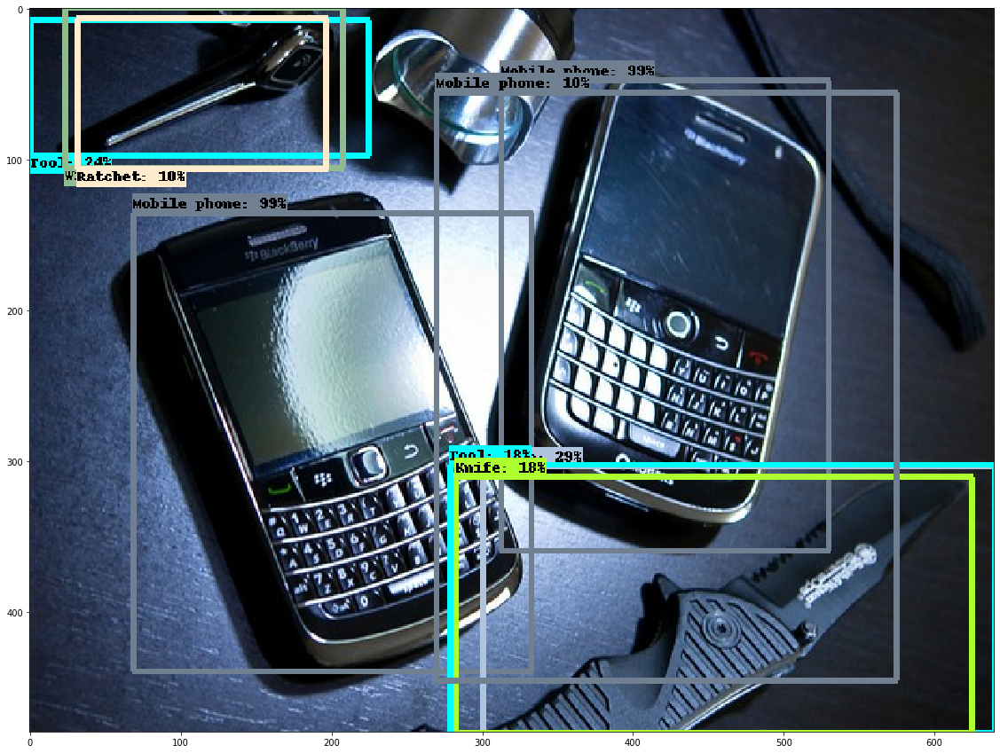

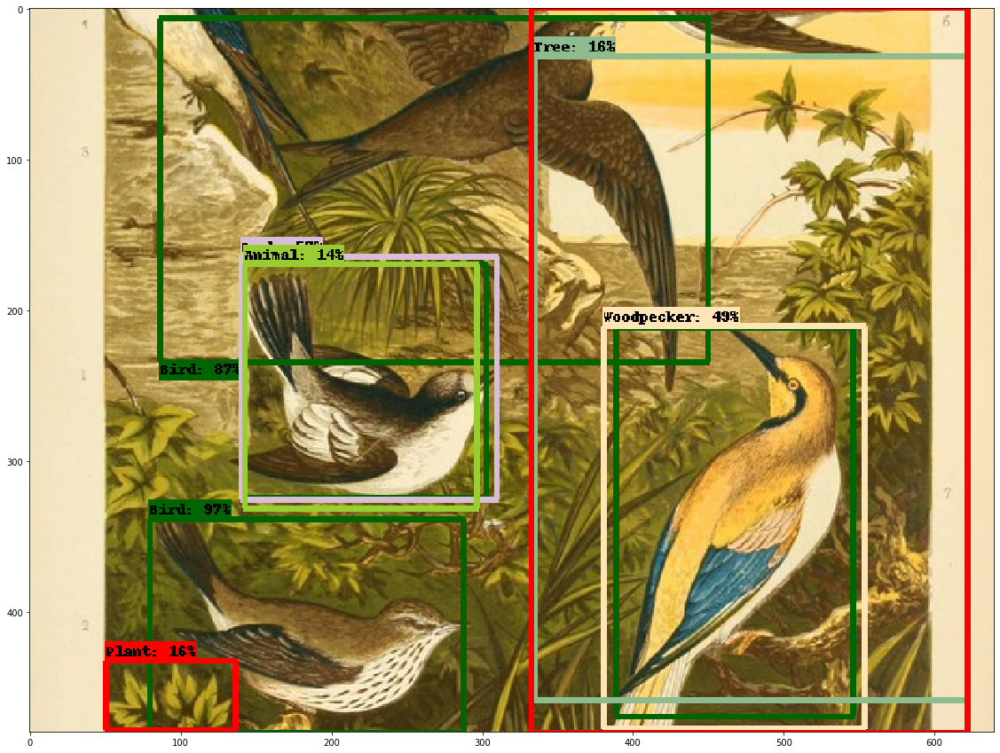

In [8]:
#image_urls = ["https://farm7.staticflickr.com/8092/8592917784_4759d3088b_o.jpg",
#              "https://farm6.staticflickr.com/2598/4138342721_06f6e177f3_o.jpg",
#              "https://c4.staticflickr.com/9/8322/8053836633_6dc507f090_o.jpg"]

#for image_url in image_urls:
#  start_time = time.time()
#  image_path = download_and_resize_image(image_url, 640, 480)
#  run_detector(detector, image_path)
#  end_time = time.time()
#  print("Inference time:")
#savefig('Object_Detection_Example')

In [10]:
run_detector(detector,"Pedestrian_Sample.png") #.PNG FILE MUST BE IN AI OBJECT DETECTION FOLDER|MUST EXECUTE CELLS 2,3,5,6,7|Working as of 11/7/19, 1:10 PM

NameError: name 'detector' is not defined

Found 100 objects.
Inference time:  128.7615737915039


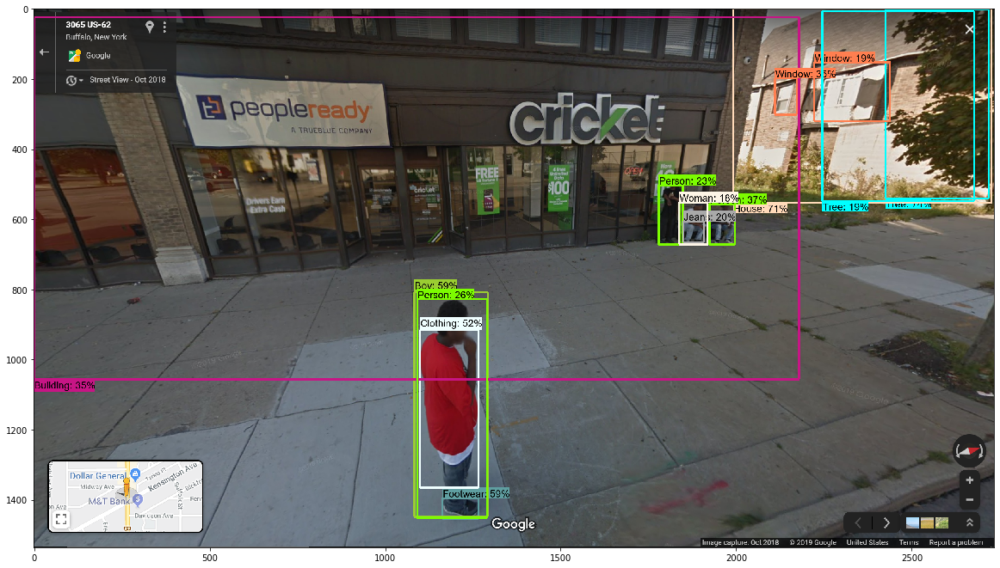

In [55]:
run_detector(detector,"Pedestrian_Sample.png") #MAX BOXES = 15
plt.savefig('Pedestrian_Sample_OD.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  208.2950882911682


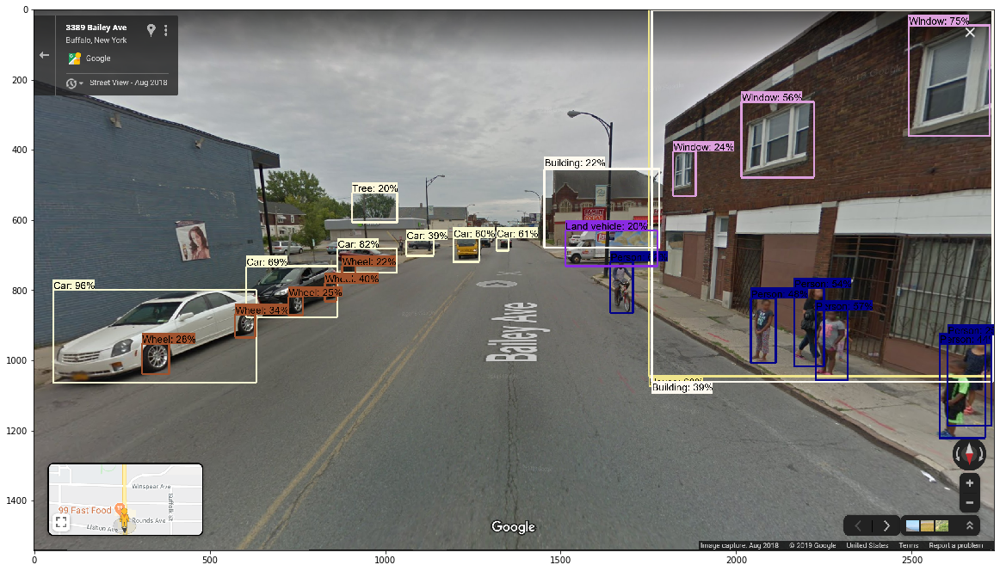

In [7]:
run_detector(detector,"Pedestrian_Sample2.png") #MAX BOXES = 25 DO NOT CHANGE
plt.savefig('Pedestrian_Sample_OD2.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  113.8338348865509


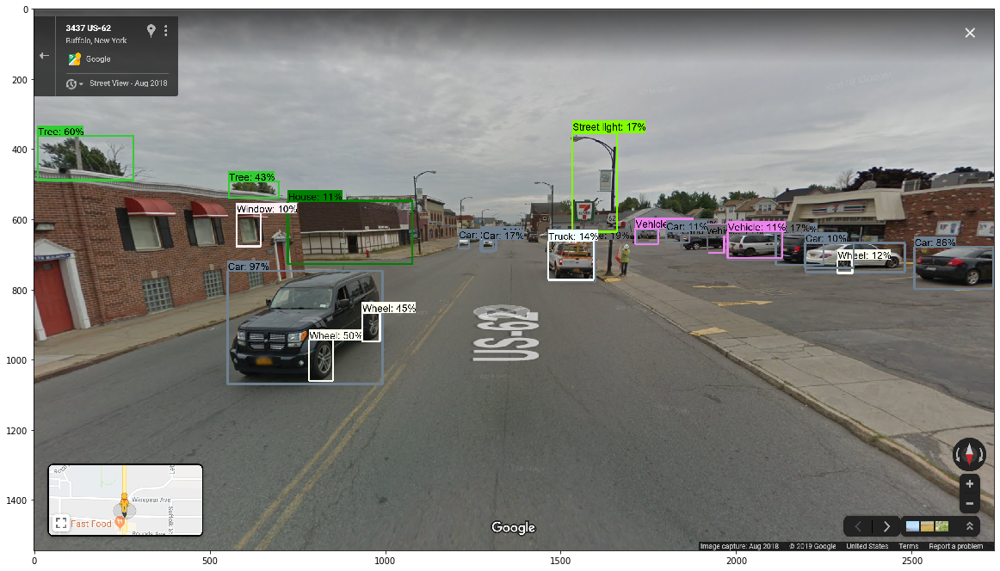

In [41]:
run_detector(detector,"Pedestrian_Sample3.png") #MAX BOXES = 25 (20 TO RECOGNIZE THE PERSON?) | 20 is good
plt.savefig('Pedestrian_Sample_OD3.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  112.92345094680786


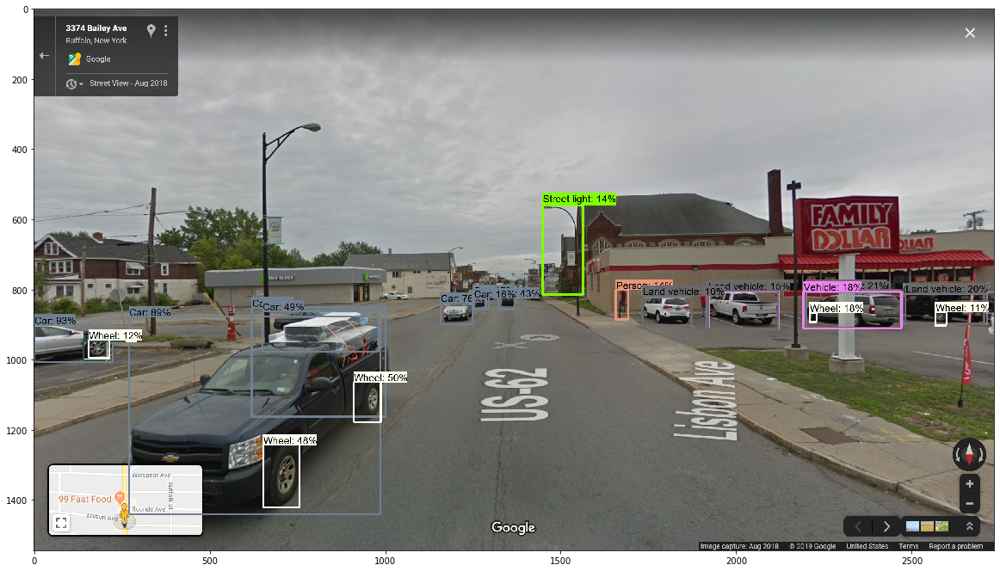

In [44]:
run_detector(detector,"Pedestrian_Sample4.png") 
plt.savefig('Pedestrian_Sample_OD4.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  124.22541832923889


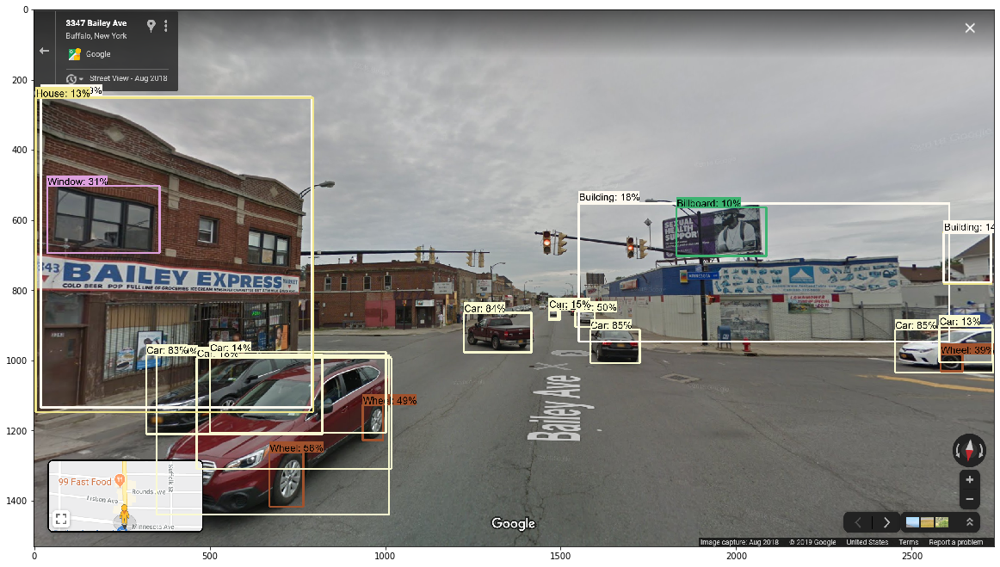

In [8]:
run_detector(detector,"Pedestrian_Sample5.png") #MAX BOXES = 20
plt.savefig('Pedestrian_Sample_OD5.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  197.91159462928772


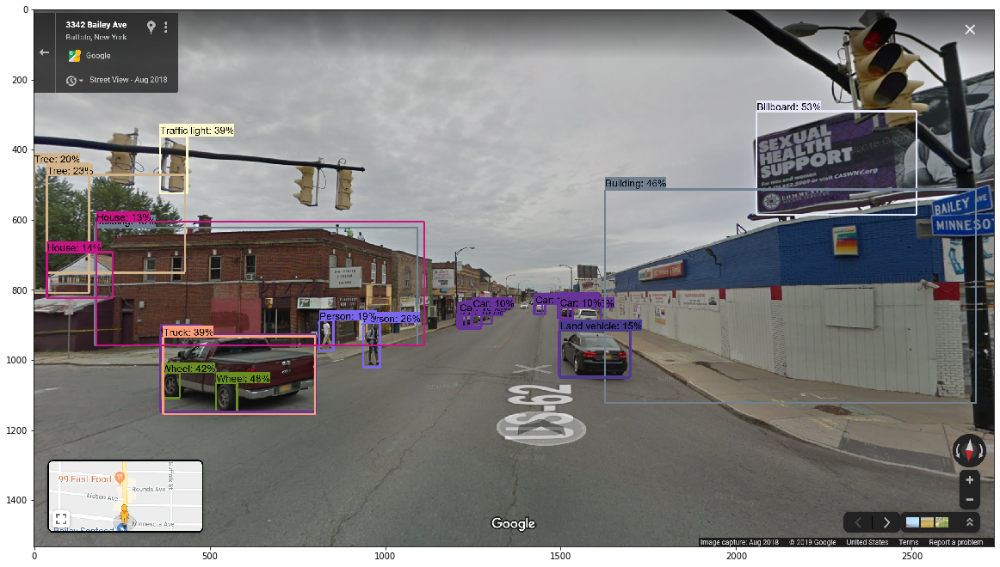

In [6]:
run_detector(detector,"Pedestrian_Sample6.png") 
plt.savefig('Pedestrian_Sample_OD6.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  336.7162890434265


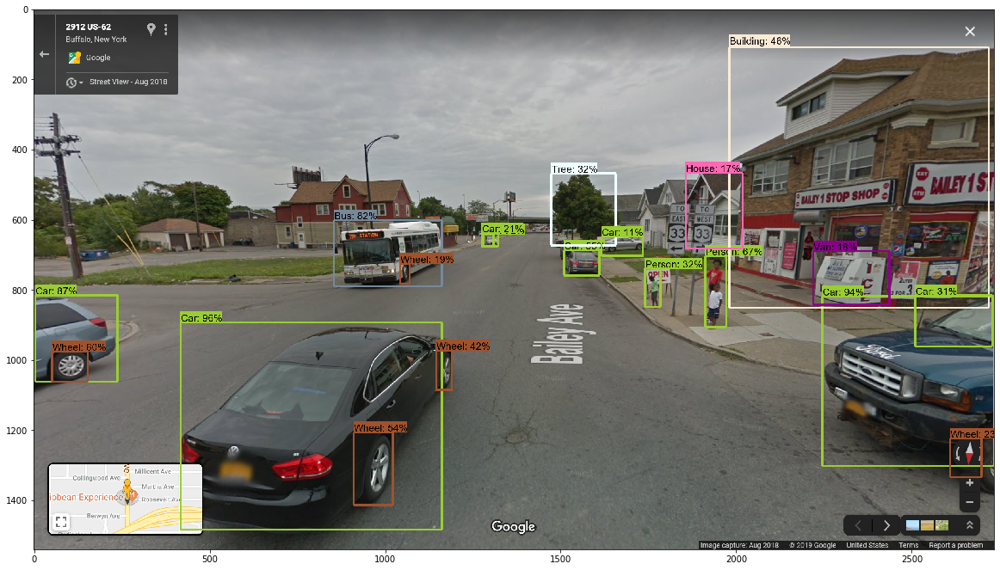

In [22]:
run_detector(detector,"Pedestrian_Sample8.png") #MAX BOXES = 25
plt.savefig('Pedestrian_Sample_OD8.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  321.5072627067566


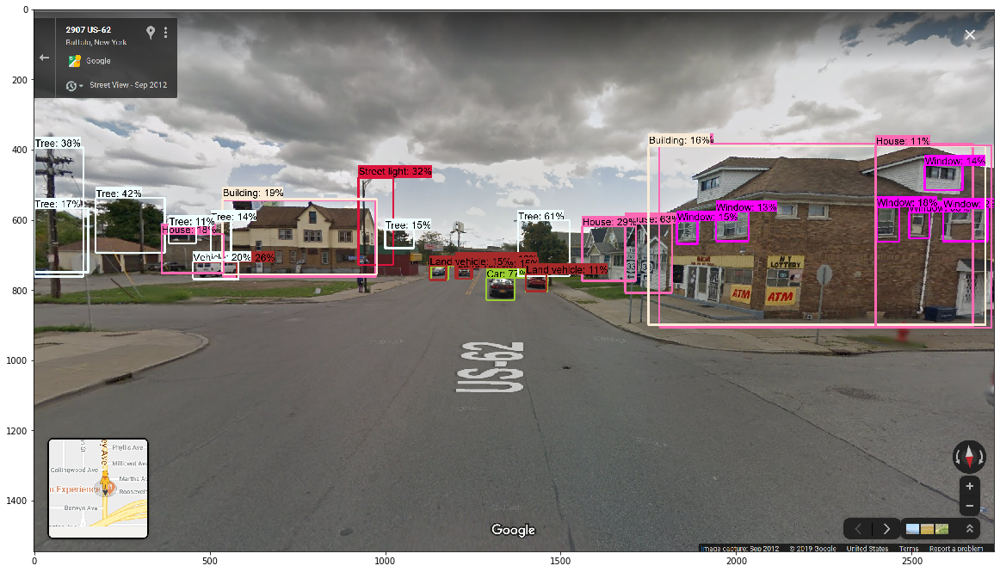

In [24]:
run_detector(detector,"Pedestrian_Sample9.png") #MAX BOXES = 50
plt.savefig('Pedestrian_Sample_OD9.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  111.33624505996704


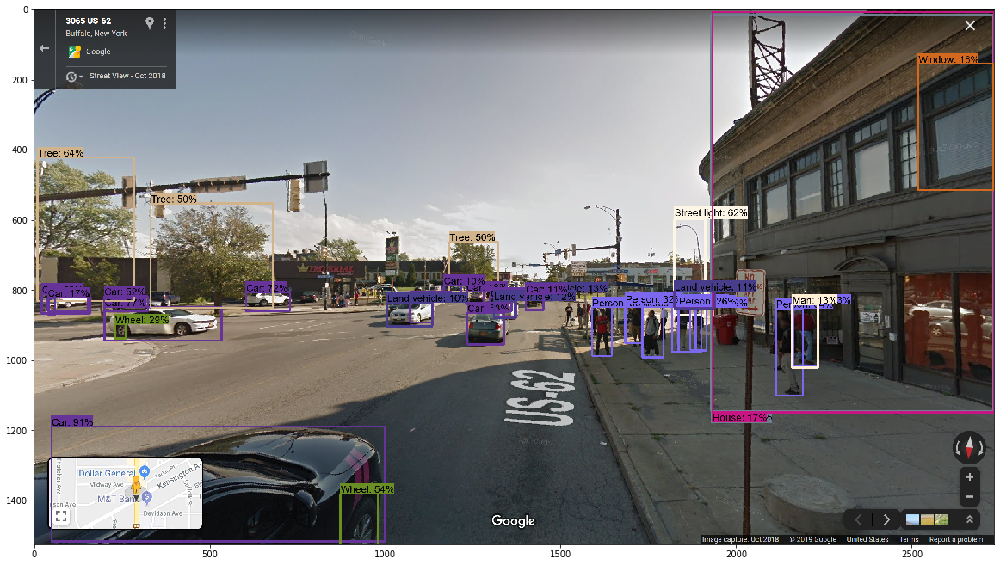

In [7]:
run_detector(detector,"Pedestrian_Sample10.png") #MAX BOXES = 99
plt.savefig('Pedestrian_Sample_OD10.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  128.83416986465454


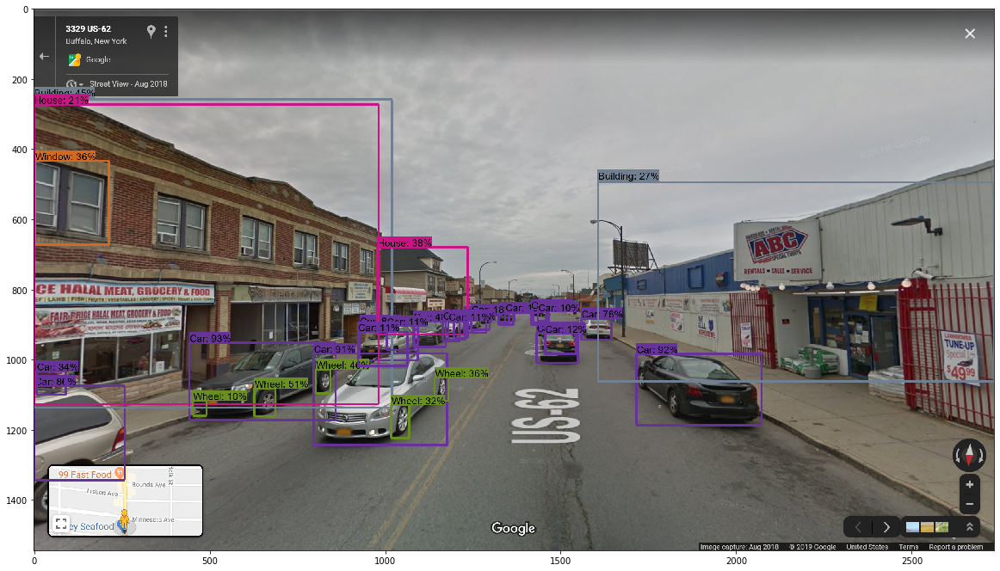

In [10]:
run_detector(detector,"Pedestrian_Sample7.png") #MAX BOXES = 99
plt.savefig('Pedestrian_Sample_OD7.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  113.47869753837585


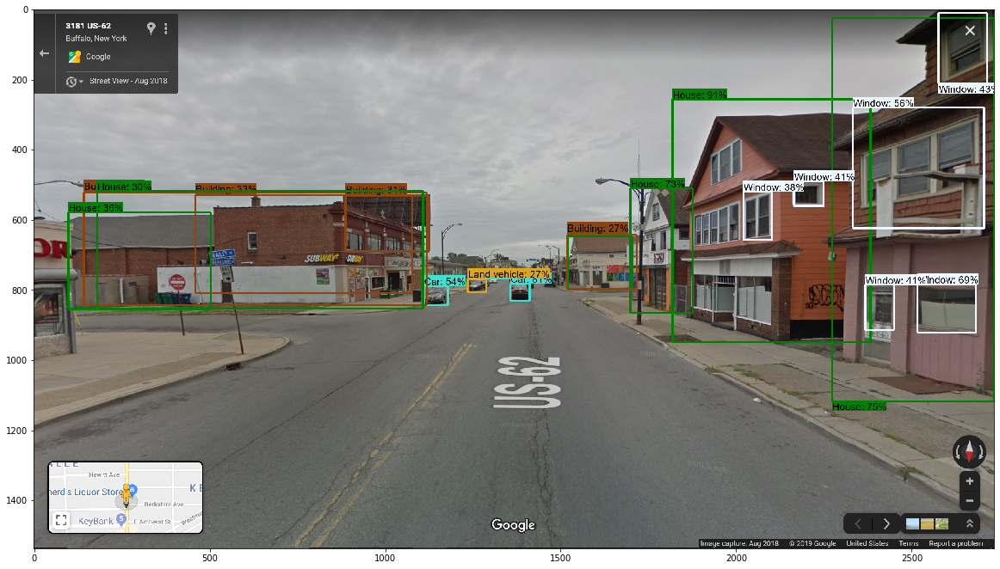

In [16]:
run_detector(detector,"Pedestrian_Sample11.png") #MAX BOXES = 20
plt.savefig('Pedestrian_Sample_OD11.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  203.06098985671997


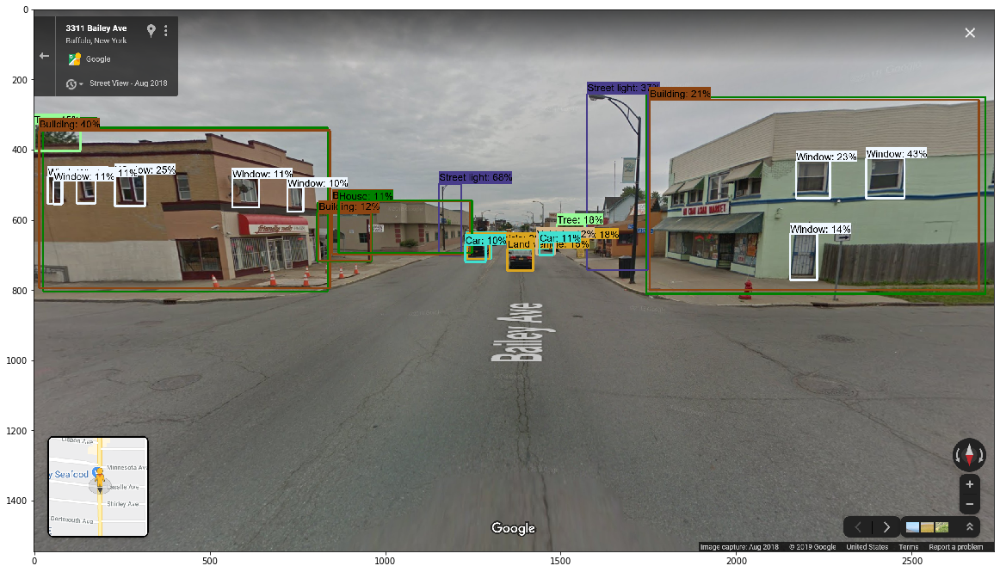

In [6]:
run_detector(detector,"Pedestrian_Sample12.png") #MAX BOXES = 99
plt.savefig('Pedestrian_Sample_OD12.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  115.08261132240295


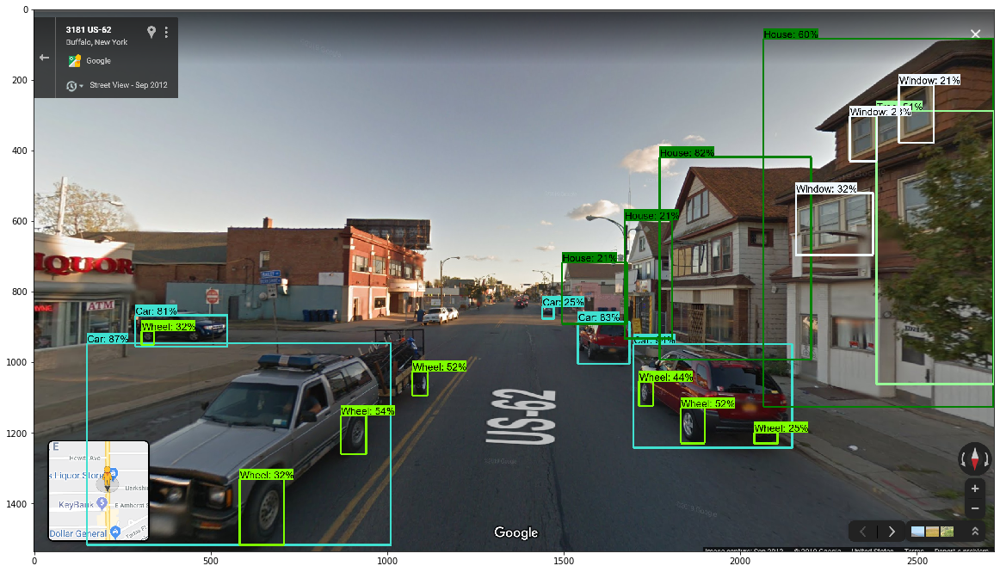

In [17]:
run_detector(detector,"Pedestrian_Sample13.png") #LOOKS GOOD. NO NEED TO CHANGS MAX BOXES XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
plt.savefig('Pedestrian_Sample_OD13.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  114.80868291854858


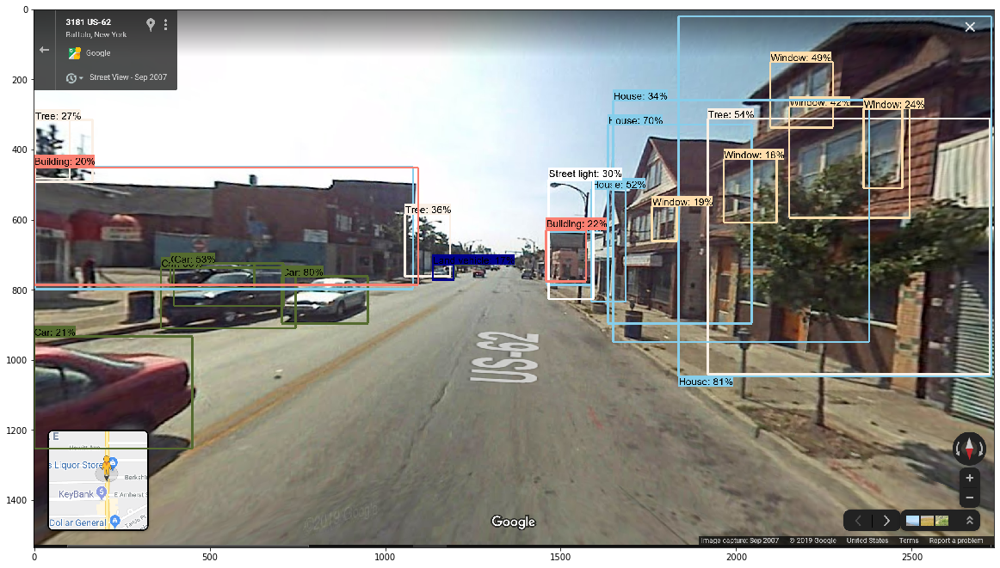

In [8]:
run_detector(detector,"Pedestrian_Sample14.png") #MAX BOXES < 30 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
plt.savefig('Pedestrian_Sample_OD14.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  117.34582829475403


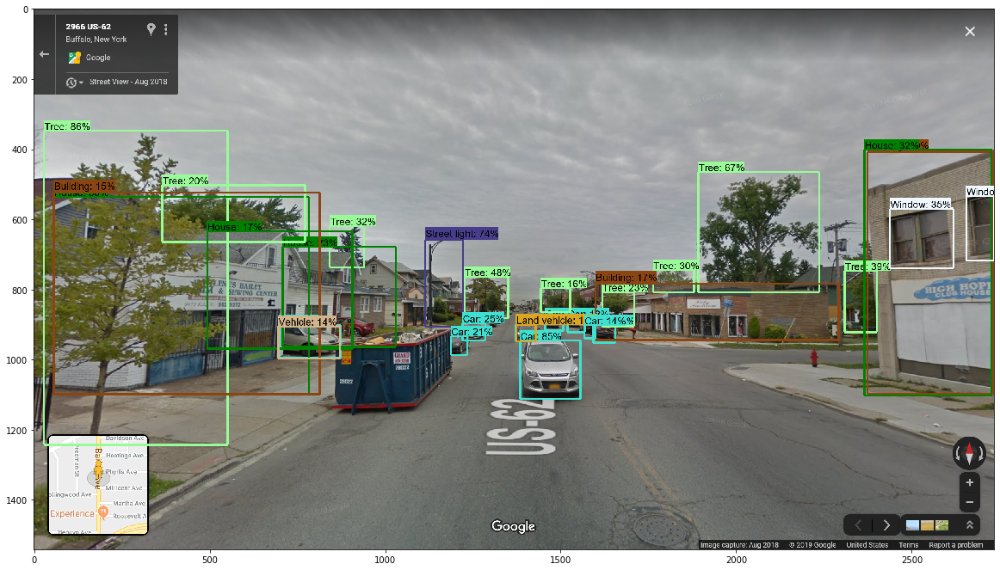

In [14]:
run_detector(detector,"Pedestrian_Sample15.png") #MAX BOXES = 99 PROBABLY GOOD. NO NEED TO CHANGE MAX BOXES XXXXXXXXXXXXXXXX
plt.savefig('Pedestrian_Sample_OD15.png', bbox_inches = 'tight')

Found 100 objects.
Inference time:  206.8684539794922


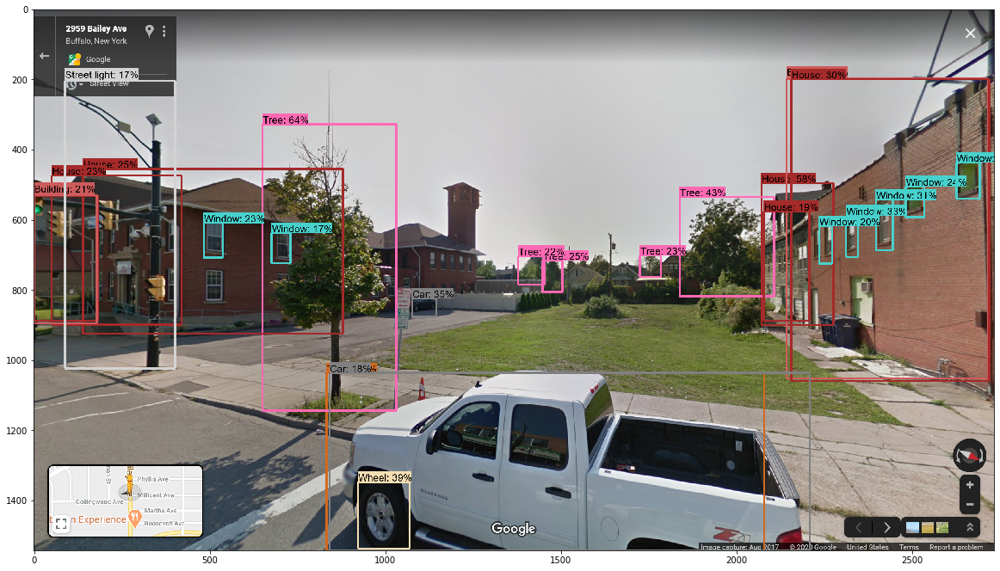

In [6]:
run_detector(detector,"Vacant_lot1.png")
plt.savefig('Vacant_lot1_OD15.png', bbox_inches = 'tight')